## **IMPORTING DRIVE**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


**IMPORT STATEMENTS**

In [ ]:
from google.colab.patches import cv2_imshow
import pandas as pd
import cv2
import math
import numpy as np

**READING THE IMAGE**

In [ ]:
image=cv2.imread("/content/drive/MyDrive/sampleimage.jpg")

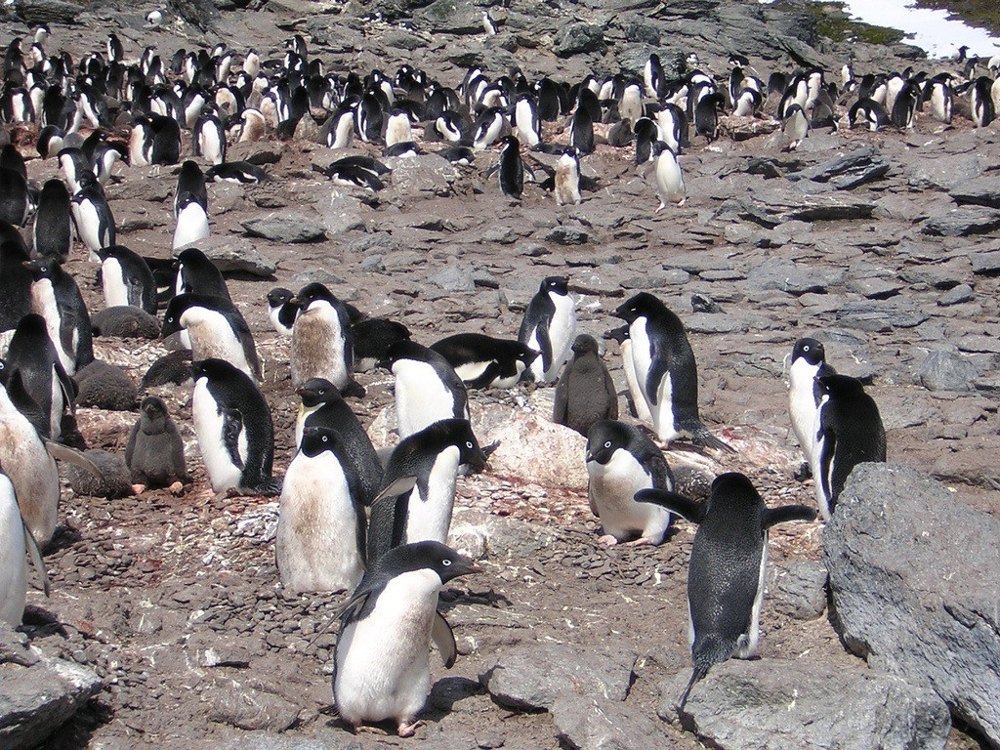

In [ ]:
cv2_imshow(image)

**MATRIX USED TO GET I, V1 AND V2 VALUES FOR EACH PIXEL**

In [ ]:
HSI_conversion_kernel = np.array([[1/3, 1/3, 1/3], [-math.sqrt(6)/6, -math.sqrt(6)/6, math.sqrt(6)/3], [1/math.sqrt(6), -2/math.sqrt(6), 0]], dtype=np.float32)

In [ ]:
blue_channel = image[:, :, 0]
green_channel = image[:, :, 1]
red_channel = image[:, :, 2]

In [ ]:

print(blue_channel)

[[75 87 99 ... 56 65 54]
 [60 68 85 ... 86 69 45]
 [80 55 71 ... 44 28 39]
 ...
 [45 37 33 ... 33 64 73]
 [38 35 35 ... 35 39 48]
 [35 40 40 ... 25 41 48]]


In [ ]:
RGB_stacked = np.stack((red_channel, green_channel, blue_channel), axis=-1)

**GETTING I, V1 AND V2 VALUES**

In [ ]:
# Create empty arrays to store the results
I_values = np.empty_like(red_channel, dtype=np.float32)
V1_values = np.empty_like(red_channel, dtype=np.float32)
V2_values = np.empty_like(red_channel, dtype=np.float32)

# Iterate through the pixels and perform the multiplication
for x in range(image.shape[0]):
    for y in range(image.shape[1]):
        I, V1, V2 = HSI_conversion_kernel.dot(RGB_stacked[x, y])
        I_values[x, y] = I
        V1_values[x, y] = V1
        V2_values[x, y] = V2


In [ ]:
S_values = np.empty_like(red_channel, dtype=np.float32)
H_values = np.empty_like(red_channel, dtype=np.float32)

**GETTING H AND S VALUES**

In [ ]:
for x in range(image.shape[0]):
    for y in range(image.shape[1]):
        S_values[x,y]=math.sqrt(math.pow(V1_values[x, y],2)+math.pow(V2_values[x, y],2))
        if V1_values[x,y]==1:
          H_values[x,y]=0
        else:
          H_values[x,y]=math.atan2(V2_values[x, y],V1_values[x, y])

In [ ]:
H_values.shape

(768, 1024)

**NORMALIZING H AND S VALUES TO THE RANGE 0-1**

In [ ]:
I_normalized=np.empty_like(red_channel, dtype=np.float32)
H_normalized=np.empty_like(red_channel, dtype=np.float32)

In [ ]:
I_min = np.min(I_values)
I_max = np.max(I_values)
for x in range(image.shape[0]):
    for y in range(image.shape[1]):
      I_normalized[x,y] = (I_values[x,y] - I_min) / (I_max - I_min)

In [ ]:
H_min = np.min(H_values)
H_max = np.max(H_values)
for x in range(image.shape[0]):
    for y in range(image.shape[1]):
      H_normalized[x,y] = (H_values[x,y] - H_min) / (H_max - H_min)

**COMPUTING RATIO MAP FOR EACH PIXEL**

In [ ]:
ratio_map_values= np.empty_like(red_channel, dtype=np.float32)

In [ ]:
for x in range(image.shape[0]):
    for y in range(image.shape[1]):
      ratio_map_values[x,y]=(H_normalized[x,y]+1)/(I_normalized[x,y]+1)

## **SHADOW MAP EVALUATION**

# THRESHOLD EVALUATION

In [ ]:
# Flatten the ratio_map_values for histogram computation
flattened_values = ratio_map_values.ravel()
flattened_values=flattened_values*255
# Round the values to the nearest integer
flattened_values = np.round(flattened_values).astype(np.uint8)
# Compute the histogram
hist, bins = np.histogram(flattened_values, bins=256, range=(0, 256))

# Normalize the histogram to get probabilities
probabilities = hist / hist.sum()

print(probabilities)

[3.43958537e-03 3.70788574e-03 3.80961100e-03 3.59344482e-03
 3.70534261e-03 3.60616048e-03 3.74476115e-03 3.76764933e-03
 3.59725952e-03 3.82868449e-03 3.76892090e-03 3.62523397e-03
 3.65066528e-03 3.83249919e-03 3.86555990e-03 4.10715739e-03
 3.74603271e-03 3.78163656e-03 3.85030111e-03 3.91133626e-03
 4.10207113e-03 3.99780273e-03 4.08935547e-03 4.06773885e-03
 4.06773885e-03 4.11224365e-03 3.80833944e-03 3.62396240e-03
 3.50952148e-03 3.81469727e-03 3.92405192e-03 3.82741292e-03
 3.91896566e-03 3.54003906e-03 3.78799438e-03 3.78545125e-03
 3.92659505e-03 3.11533610e-03 3.68754069e-03 3.52096558e-03
 3.01869710e-03 2.64612834e-03 3.05302938e-03 2.76311239e-03
 1.77637736e-03 2.49608358e-03 2.48591105e-03 2.40580241e-03
 2.04594930e-03 2.22905477e-03 1.78273519e-03 1.64540609e-03
 1.58309937e-03 1.26520793e-03 1.50044759e-03 1.01216634e-03
 1.19018555e-03 9.76562500e-04 1.02361043e-03 7.60396322e-04
 8.60850016e-04 7.94728597e-04 7.19706217e-04 8.03629557e-04
 7.32421875e-04 5.683898

In [ ]:
i_values = np.arange(256)  # [0, 1, ..., 255]

# initialize a high value for min_variance
min_variance = float('inf')

# placeholder for optimal T
optimal_T = 0

for potential_T in range(256):
    # Compute w1, w2
    w1 = np.sum(probabilities[0:potential_T+1])
    w2 = np.sum(probabilities[potential_T+1:])

    # Compute u1, u2
    u1 = np.sum(i_values[0:potential_T+1] * probabilities[0:potential_T+1]) / (w1 + 1e-9)
    u2 = np.sum(i_values[potential_T+1:] * probabilities[potential_T+1:]) / (w2 + 1e-9)

    # Compute the sum of squared differences
    variance_1 = np.sum(probabilities[0:potential_T+1] * (i_values[0:potential_T+1] - u1)**2)
    variance_2 = np.sum(probabilities[potential_T+1:] * (i_values[potential_T+1:] - u2)**2)

    total_variance = variance_1 + variance_2

    # check if the current total_variance is the minimum
    if total_variance < min_variance:
        min_variance = total_variance
        optimal_T = potential_T

print("Optimal T:", optimal_T)


Optimal T: 114


In [ ]:
shadow_map_values= np.empty_like(ratio_map_values, dtype=np.float32)

In [ ]:
optimal_T_scaled = optimal_T / 255
shadow_map_values = np.zeros_like(ratio_map_values, dtype=np.uint8)  # initialize to zeros

for x in range(image.shape[0]):
    for y in range(image.shape[1]):
        shadow_map_values[x, y] = 1 if ratio_map_values[x,y] > optimal_T_scaled else 0


# APPLYING SHADOW TO IMAGE

In [ ]:
shadow_image= np.empty_like(image, dtype=np.float32)

In [ ]:
lambda_value=0.4

In [ ]:
for x in range(image.shape[0]):
    for y in range(image.shape[1]):
      shadow_image[x,y]=lambda_value*image[x,y]+(1-lambda_value)*shadow_map_values[x,y] if shadow_map_values[x,y]==1 else image[x,y]

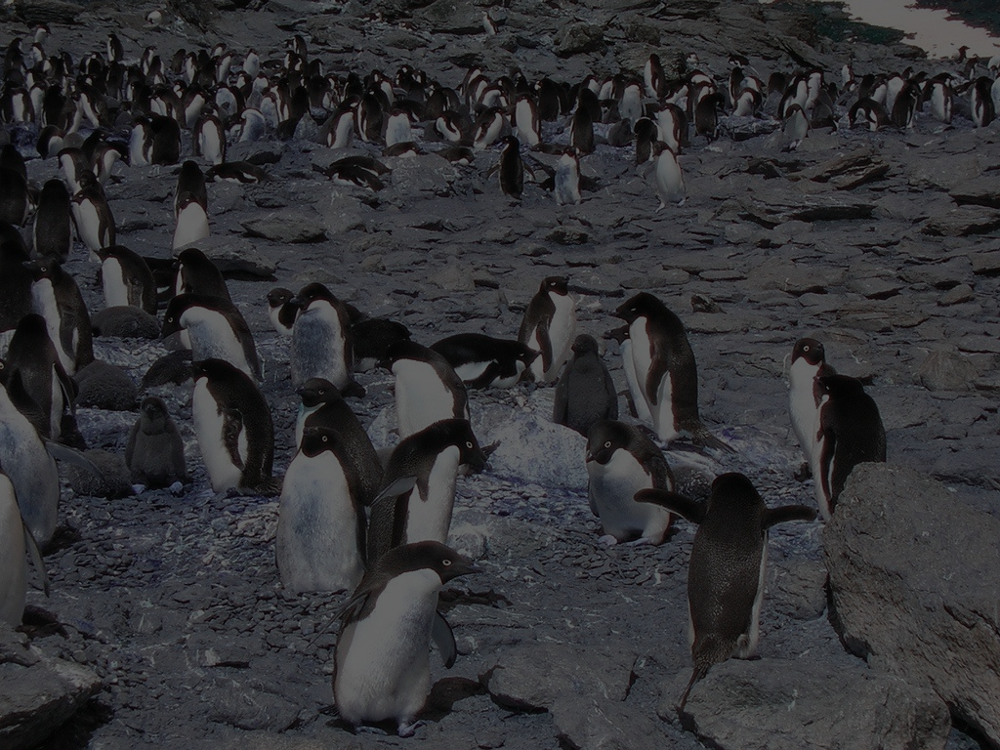

In [ ]:
from google.colab.patches import cv2_imshow

shadow_image_rgb = cv2.cvtColor(shadow_image.astype(np.uint8), cv2.COLOR_BGR2RGB)
cv2_imshow(shadow_image_rgb)

# 1.1.2 LINE DRAFT GENERATION

*GRAYSCALE CONVERSION*

In [ ]:
# Convert to grayscale
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

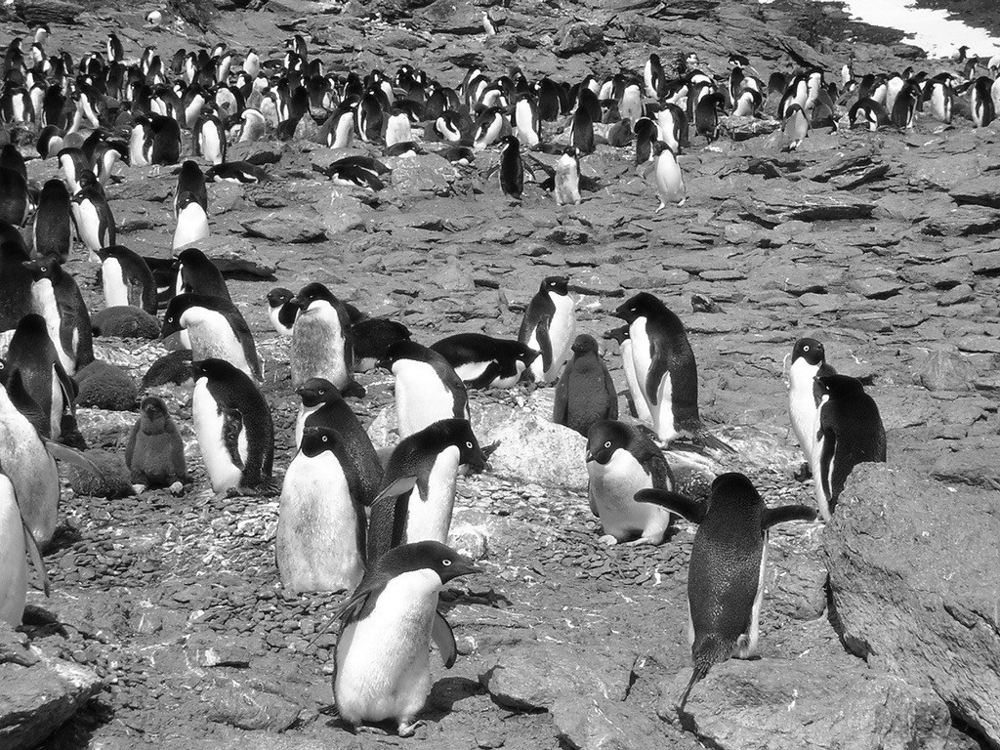

In [ ]:
cv2_imshow(gray_image)

*BILATERAL FILTERING*

In [ ]:
import numpy as np
from tqdm import tqdm  # Import tqdm for progress bar

def bilateral_filter(image, d, sigma_s, sigma_r):
    def f_s(s):
        return np.exp(-s**2 / (2 * sigma_s**2))

    def f_r(r):
        return np.exp(-r**2 / (2 * sigma_r**2))

    output = np.zeros_like(image, dtype=np.float32)
    h, w = image.shape[:2]
    r = d // 2

    for x in tqdm(range(h), desc="Rows"):  # Use tqdm to iterate over rows
        for y in tqdm(range(w), desc="Columns", leave=False):  # Use tqdm to iterate over columns
            Wp = 0
            I_filtered = 0
            for i in range(-r, r+1):
                for j in range(-r, r+1):
                    if x+i < 0 or x+i >= h or y+j < 0 or y+j >= w:
                        continue

                    spatial_weight = f_s(np.linalg.norm([i, j]))
                    range_weight = f_r(abs(float(image[x+i, y+j]) - float(image[x, y])))

                    weight = spatial_weight * range_weight

                    I_filtered += float(image[x+i, y+j]) * weight
                    Wp += weight

            output[x, y] = I_filtered / Wp

    return output


In [ ]:
bilateral_filtered_image=bilateral_filter(gray_image,3,10,20)

Rows: 100%|██████████| 768/768 [02:21<00:00,  5.42it/s]


*APPLYING SOBEL OPERATOR*

In [ ]:
sobel_x = np.array([
    [-1, 0, 1],
    [-2, 0, 2],
    [-1, 0, 1]
])

sobel_y = np.array([
    [-1, -2, -1],
    [0, 0, 0],
    [1, 2, 1]
])


In [ ]:
def convolve2d(image, kernel):
    output = np.zeros_like(image)
    image_padded = np.pad(image, [(kernel.shape[0]//2, kernel.shape[0]//2),
                                  (kernel.shape[1]//2, kernel.shape[1]//2)], mode='constant')
    for x in range(image.shape[1]):
        for y in range(image.shape[0]):
            output[y, x] = (kernel * image_padded[y:y+kernel.shape[0], x:x+kernel.shape[1]]).sum()
    return output


In [ ]:
grad_x = convolve2d(bilateral_filtered_image, sobel_x)
grad_y = convolve2d(bilateral_filtered_image, sobel_y)

In [ ]:
edge_map = np.sqrt(grad_x**2 + grad_y**2)

In [ ]:
threshold_value = 55
line_map = np.where(edge_map > threshold_value, 255, 0).astype(np.uint8)

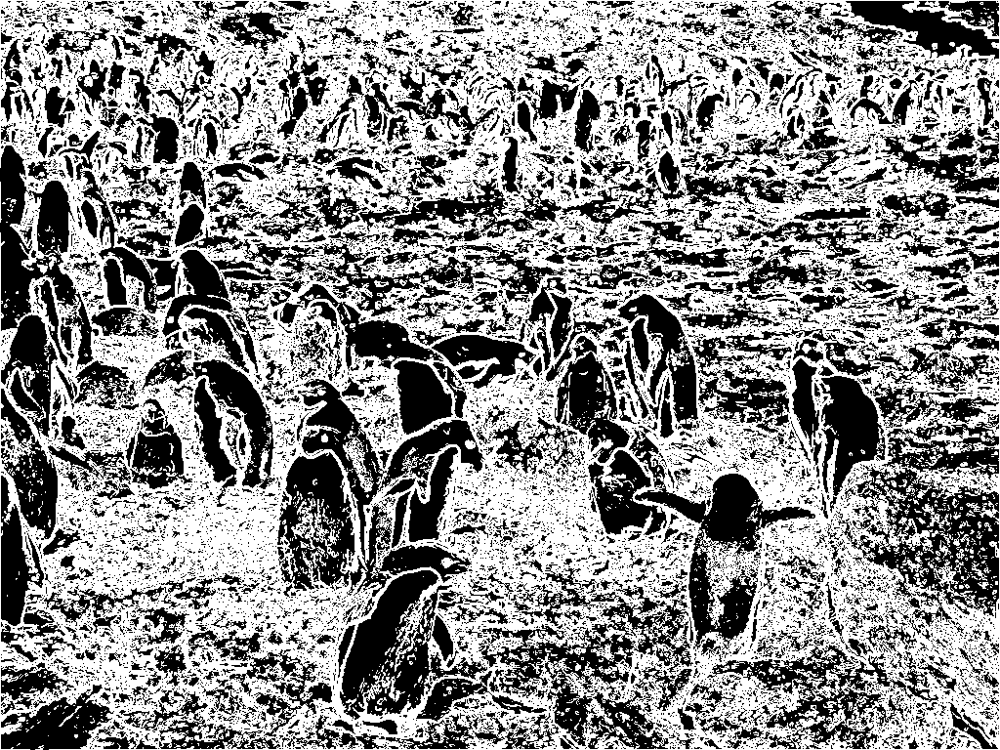

In [ ]:
cv2_imshow(line_map)

In [ ]:
inverse_line_map = 255 - line_map

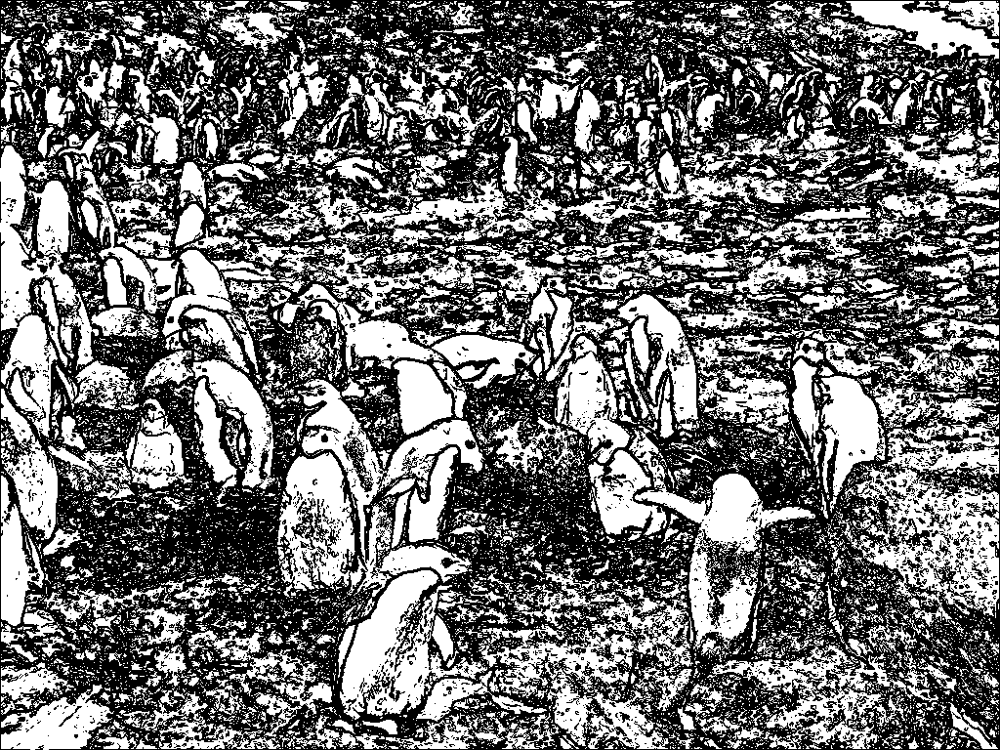

In [ ]:
cv2_imshow(inverse_line_map)

# 1.2 COLOR ADJUSTMENT

In [ ]:
LAB_image = cv2.cvtColor(shadow_image_rgb, cv2.COLOR_BGR2Lab)

In [ ]:
L_channel = LAB_image[:, :, 0]
A_channel = LAB_image[:, :, 1]
B_channel = LAB_image[:, :, 2]

In [ ]:
median_L = np.median(L_channel)

In [ ]:
LAB_image[:, :, 0] = median_L  # Set the L channel to the median value

In [ ]:
# Converting Lab image back to BGR color space
BGR_image = cv2.cvtColor(LAB_image, cv2.COLOR_Lab2BGR)

In [ ]:
color_adjusted_image=np.zeros_like(image)

In [ ]:
rho=0.8

In [ ]:
for x in range(image.shape[0]):
    for y in range(image.shape[1]):
      color_adjusted_image[x,y]=shadow_image_rgb[x,y]*((1+np.tanh(rho*(BGR_image[x,y]-128)))/2)

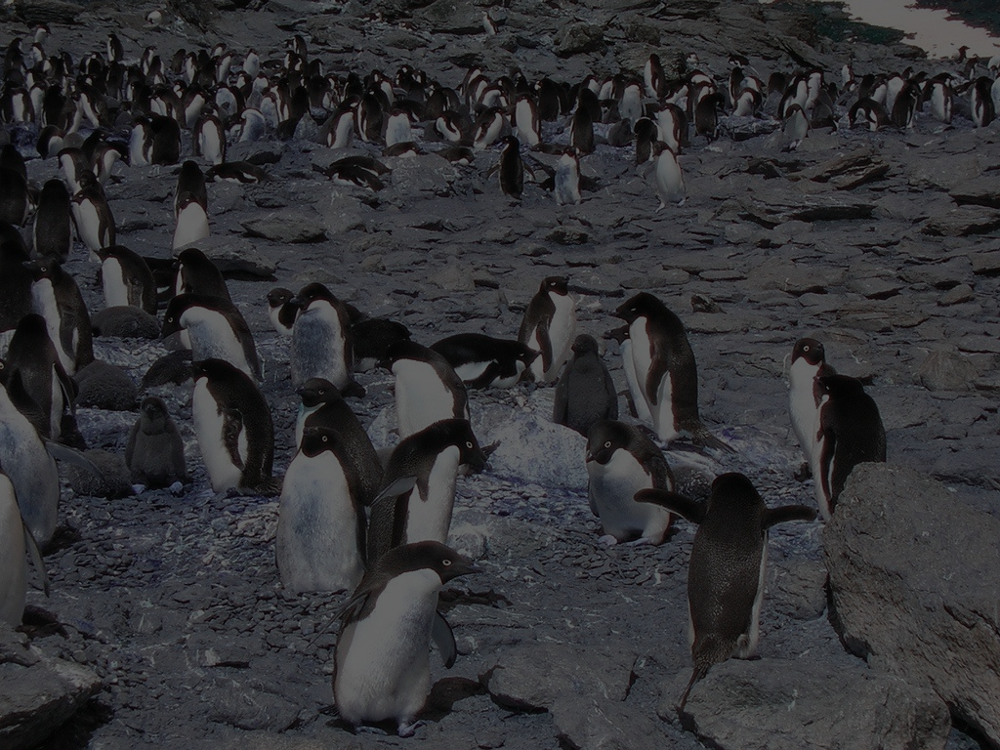

In [ ]:
cv2_imshow(color_adjusted_image)

In [ ]:
hsv_image = cv2.cvtColor(color_adjusted_image, cv2.COLOR_RGB2HSV)

# Extract the Saturation channel
s_channel = hsv_image[:, :, 1].astype(np.float32)

# Apply linear saturation correction
a = 1.2 #factor
b = 3  # offset
s_channel = a * s_channel + b

# Clip values to be in the range [0, 255] and convert back to uint8
s_channel = np.clip(s_channel, 0, 255).astype(np.uint8)

# Replace the original Saturation channel with the adjusted one
hsv_image[:, :, 1] = s_channel

# Convert the HSV image back to RGB
corrected_rgb_image = cv2.cvtColor(hsv_image, cv2.COLOR_HSV2RGB)

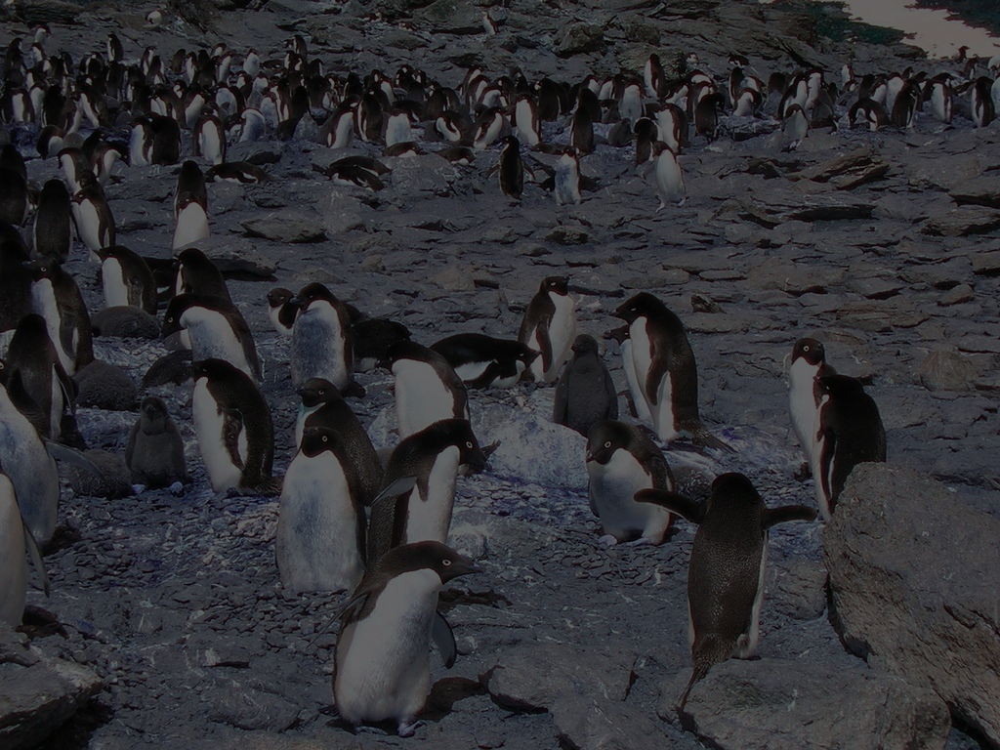

In [ ]:
cv2_imshow(corrected_rgb_image)

*PRODUCING ARTISTIC RENDERED IMAGE*

In [ ]:
artistic_image=np.zeros_like(image)

In [ ]:
beta=0.8

In [ ]:
for x in range(image.shape[0]):
    for y in range(image.shape[1]):
      artistic_image[x,y]=beta*corrected_rgb_image[x,y]+(1-beta)*inverse_line_map[x,y] if inverse_line_map[x,y]==0 else corrected_rgb_image[x,y]

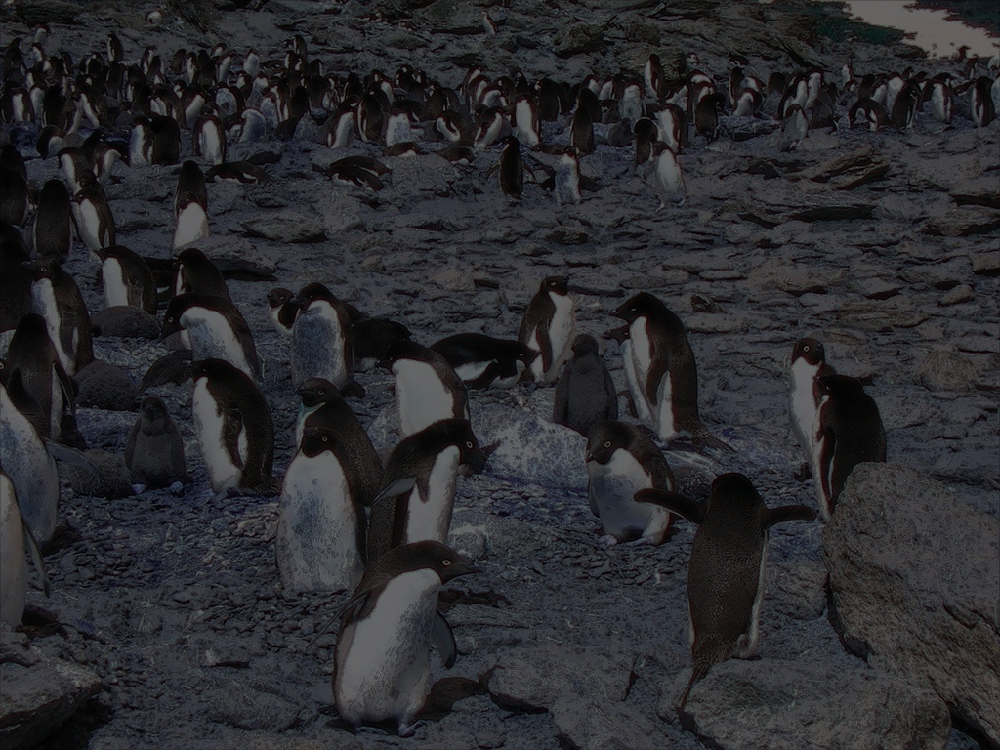

In [ ]:
cv2_imshow(artistic_image)

# **QUANTIZED RENDERING**

*MEDIAN CUT ALGORITHM*

space_with_highest_range: 1
median_index: 393216
space_with_highest_range: 0
median_index: 196608
space_with_highest_range: 2
median_index: 98304
space_with_highest_range: 1
median_index: 49152
space_with_highest_range: 0
median_index: 24576
space_with_highest_range: 2
median_index: 12288
space_with_highest_range: 1
median_index: 6144
space_with_highest_range: 0
median_index: 3072
to quantize:  3072
to quantize:  3072
space_with_highest_range: 0
median_index: 3072
to quantize:  3072
to quantize:  3072
space_with_highest_range: 2
median_index: 6144
space_with_highest_range: 1
median_index: 3072
to quantize:  3072
to quantize:  3072
space_with_highest_range: 1
median_index: 3072
to quantize:  3072
to quantize:  3072
space_with_highest_range: 0
median_index: 12288
space_with_highest_range: 2
median_index: 6144
space_with_highest_range: 1
median_index: 3072
to quantize:  3072
to quantize:  3072
space_with_highest_range: 1
median_index: 3072
to quantize:  3072
to quantize:  3072
space_with_

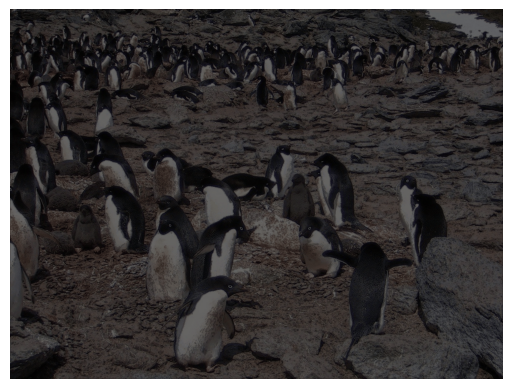

space_with_highest_range: 1
median_index: 393216
space_with_highest_range: 0
median_index: 196608
space_with_highest_range: 2
median_index: 98304
space_with_highest_range: 1
median_index: 49152
space_with_highest_range: 0
median_index: 24576
space_with_highest_range: 2
median_index: 12288
space_with_highest_range: 1
median_index: 6144
space_with_highest_range: 0
median_index: 3072
to quantize:  3072
to quantize:  3072
space_with_highest_range: 0
median_index: 3072
to quantize:  3072
to quantize:  3072
space_with_highest_range: 2
median_index: 6144
space_with_highest_range: 1
median_index: 3072
to quantize:  3072
to quantize:  3072
space_with_highest_range: 1
median_index: 3072
to quantize:  3072
to quantize:  3072
space_with_highest_range: 0
median_index: 12288
space_with_highest_range: 2
median_index: 6144
space_with_highest_range: 1
median_index: 3072
to quantize:  3072
to quantize:  3072
space_with_highest_range: 1
median_index: 3072
to quantize:  3072
to quantize:  3072
space_with_

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from skimage.io import imread

def median_cut_quantize(img, img_arr):
    # when it reaches the end, color quantize
    print("to quantize: ", len(img_arr))
    r_average = np.mean(img_arr[:,0])
    g_average = np.mean(img_arr[:,1])
    b_average = np.mean(img_arr[:,2])

    for data in img_arr:
        quantized_image[data[3]][data[4]] = [r_average, g_average, b_average]

def split_into_buckets(img, img_arr, depth):

    if len(img_arr) == 0:
        return

    if depth == 0:
        median_cut_quantize(img, img_arr)
        return

    r_range = np.max(img_arr[:,0]) - np.min(img_arr[:,0])
    g_range = np.max(img_arr[:,1]) - np.min(img_arr[:,1])
    b_range = np.max(img_arr[:,2]) - np.min(img_arr[:,2])

    space_with_highest_range = 0

    if g_range >= r_range and g_range >= b_range:
        space_with_highest_range = 1
    elif b_range >= r_range and b_range >= g_range:
        space_with_highest_range = 2
    elif r_range >= b_range and r_range >= g_range:
        space_with_highest_range = 0

    print("space_with_highest_range:",space_with_highest_range)

    # sort the image pixels by color space with highest range
    # and find the median and divide the array.
    img_arr = img_arr[img_arr[:,space_with_highest_range].argsort()]
    median_index = int((len(img_arr)+1)/2)
    print("median_index:", median_index)


    #split the array into two buckets along the median
    split_into_buckets(img, img_arr[0:median_index], depth-1)
    split_into_buckets(img, img_arr[median_index:], depth-1)

flattened_img_array = []
for rindex, rows in enumerate(artistic_image):
    for cindex, color in enumerate(rows):
        flattened_img_array.append([color[0],color[1],color[2],rindex, cindex])

flattened_img_array = np.array(flattened_img_array)


# Define the dimensions of the quantized image
quantized_image = np.zeros_like(artistic_image)

# Perform median cut quantization
split_into_buckets(quantized_image, flattened_img_array, 8)

# Display the quantized image
plt.imshow(quantized_image.astype(np.uint8))
plt.axis('off')
plt.show()
# the 3rd parameter represents how many colors are needed in the power of 2. If the parameter
# passed is 4 its means 2^4 = 16 colors

split_into_buckets(quantized_image, flattened_img_array, 8)

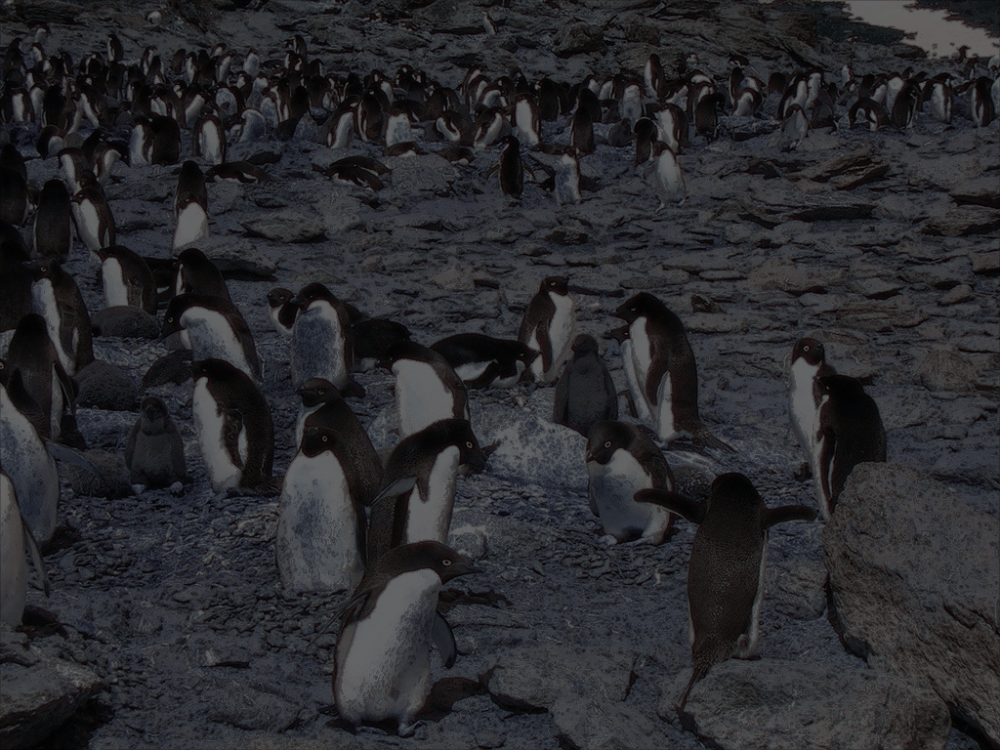

In [ ]:
cv2_imshow(quantized_image)

In [ ]:
from tqdm import tqdm

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
def mse(original, modified):
    return np.mean((original - modified) ** 2)

In [ ]:
import numpy as np
import cv2

def get_new_val(old_val, nc):
    return np.round(old_val * (nc - 1)) / (nc - 1)

def floyd_steinberg_dithering(img, nc):
    arr = np.array(img, dtype=float) / 255

    new_height, new_width, _ = arr.shape  # Get image dimensions

    for ir in range(new_height):
        for ic in range(new_width):
            old_val = arr[ir, ic].copy()
            new_val = get_new_val(old_val, nc)
            arr[ir, ic] = new_val
            err = old_val - new_val

            if ic < new_width - 1:
                arr[ir, ic+1] += err * 7/16
            if ir < new_height - 1:
                if ic > 0:
                    arr[ir+1, ic-1] += err * 3/16
                arr[ir+1, ic] += err * 5/16
                if ic < new_width - 1:
                    arr[ir+1, ic+1] += err / 16

    carr = np.array(arr / np.max(arr, axis=(0,1)) * 255, dtype=np.uint8)

    return carr


In [ ]:
dithered_image = floyd_steinberg_dithering(quantized_image, nc=4)

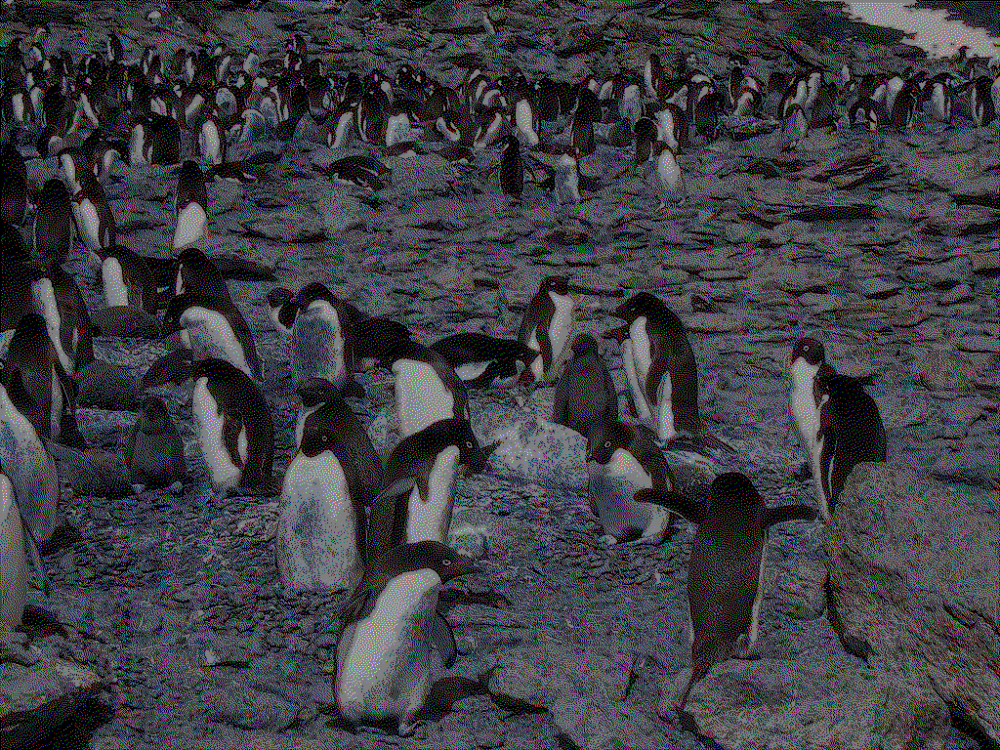

In [ ]:
cv2_imshow(dithered_image)

In [ ]:
import numpy as np

def mse(image1, image2):
    diff = image1.astype("float") - image2.astype("float")
    squared_diff = diff ** 2
    mse = np.mean(squared_diff)
    return mse


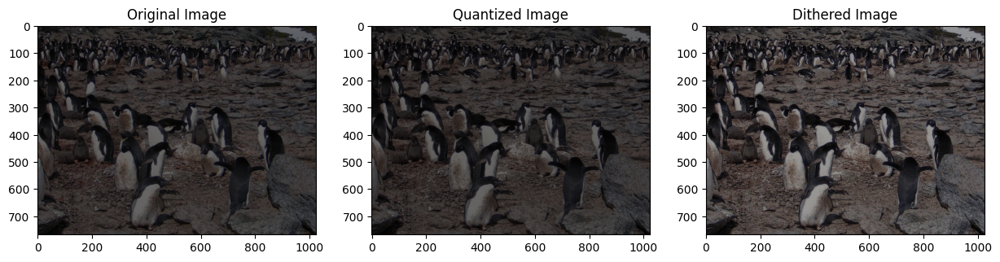

Quantization Error (without dithering): 2.5721969604492188
Quantization Error (with dithering): 3509.956342061361


In [ ]:
# Display the images
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.imshow(artistic_image)
plt.title("Original Image")

plt.subplot(1, 3, 2)
plt.imshow(quantized_image)
plt.title("Quantized Image")

plt.subplot(1, 3, 3)
plt.imshow(dithered_image)
plt.title("Dithered Image")

plt.show()

# Compute and print the quantization errors
print("Quantization Error (without dithering):", mse(artistic_image, quantized_image))
print("Quantization Error (with dithering):", mse(quantized_image, dithered_image))

# 3.ARTISTIC STYLE TRANSFER

In [ ]:
image2=cv2.imread("/content/drive/MyDrive/800px-Hopetoun_falls.jpg")

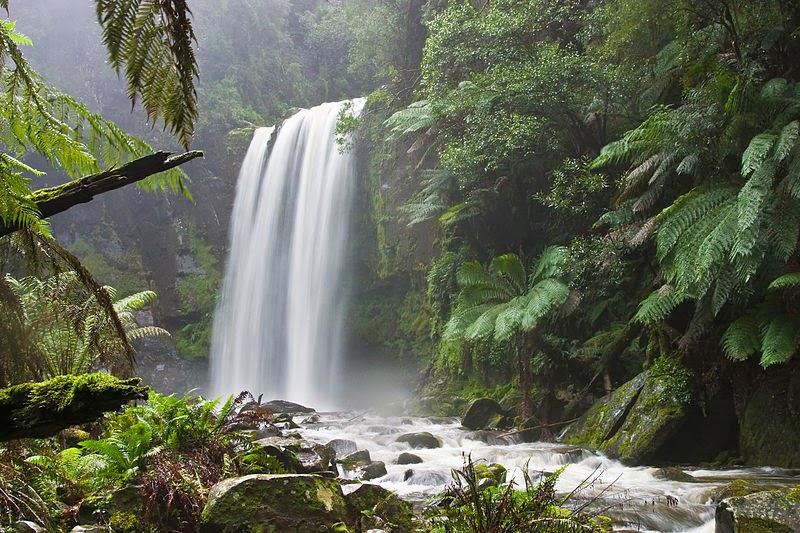

In [ ]:
cv2_imshow(image2)

*WITHOUT SWATCHES*

In [ ]:
grayscale_image2=cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)

In [ ]:
# Create LAB image with L channel from grayscale_image2 and a, b channels set to 0
LAB_image2_intensity = np.stack((grayscale_image2, np.zeros_like(grayscale_image2), np.zeros_like(grayscale_image2)), axis=-1)

In [ ]:
L_channel2 = LAB_image2_intensity[:, :, 0]
A_channel2 = LAB_image2_intensity[:, :, 1]
B_channel2 = LAB_image2_intensity[:, :, 2]

In [ ]:
LAB_image1 = cv2.cvtColor(artistic_image, cv2.COLOR_BGR2Lab)
L_channel1 = LAB_image1[:, :, 0]
A_channel1 = LAB_image1[:, :, 1]
B_channel1 = LAB_image1[:, :, 2]

In [ ]:
# Calculate histograms
hist_L1, _ = np.histogram(L_channel1, bins=256, range=(0, 256))
hist_L2, _ = np.histogram(L_channel2, bins=256, range=(0, 256))

In [ ]:
# Calculate cumulative distribution functions (CDFs)
cdf_L1 = hist_L1.cumsum()
cdf_L2 = hist_L2.cumsum()

In [ ]:
# Normalize CDFs
#cdf_L1 = cdf_L1 / cdf_L1[-1]
#cdf_L2 = cdf_L2 / cdf_L2[-1]

In [ ]:
# Create a lookup table for remapping
LUT = np.interp(cdf_L1, cdf_L2, np.arange(256))

In [ ]:
# Apply luminance remapping to source LAB image
L_channel1_remapped = LUT[L_channel1.astype(int)]
LAB_image1_remapped = LAB_image1.copy()
LAB_image1_remapped[:, :, 0] = L_channel1_remapped

In [ ]:
import cv2
import numpy as np

def compute_neighborhood_statistics(image, neighborhood_size):
    padding = neighborhood_size // 2
    statistics = np.zeros_like(image, dtype=float)

    for x in range(padding, image.shape[0] - padding):
        for y in range(padding, image.shape[1] - padding):
            neighborhood = image[x-padding:x+padding+1, y-padding:y+padding+1, 0]
            statistics[x, y, 0] = np.std(neighborhood)

    return statistics


neighborhood_size = 5

In [ ]:
neighborhood_statistics2 = compute_neighborhood_statistics(LAB_image2_intensity, neighborhood_size)
neighborhood_statistics1 = compute_neighborhood_statistics(LAB_image1_remapped, neighborhood_size)

In [ ]:
def sample_color_samples(image, num_samples):
    height, width, _ = image.shape
    sampled_coordinates = np.random.randint(0, height, size=(num_samples, 2))
    color_samples = image[sampled_coordinates[:, 0], sampled_coordinates[:, 1]]

    return color_samples

# Assuming LAB_image1 contains the LAB image of the source color image
num_samples = 200
color_samples = sample_color_samples(LAB_image1_remapped, num_samples)
print(color_samples)

[[132 141 132]
 [198 128 123]
 [ 28 128 128]
 [152 128 124]
 [255 129 128]
 [255 127 128]
 [255 129 124]
 [105 131 127]
 [255 128 126]
 [103 131 130]
 [255 130 125]
 [121 130 125]
 [ 56 128 127]
 [ 23 128 127]
 [255 129 126]
 [255 130 126]
 [111 129 124]
 [ 39 128 128]
 [166 128 124]
 [255 129 123]
 [ 76 128 129]
 [255 129 124]
 [255 130 124]
 [ 53 128 130]
 [255 129 123]
 [255 128 127]
 [ 56 130 126]
 [ 33 128 127]
 [ 48 128 128]
 [255 129 123]
 [ 39 130 126]
 [255 127 126]
 [152 128 126]
 [ 76 132 122]
 [255 126 129]
 [255 129 123]
 [  5 128 127]
 [176 129 124]
 [198 127 122]
 [157 128 126]
 [221 129 125]
 [255 128 123]
 [255 127 128]
 [255 130 130]
 [ 85 128 127]
 [255 129 126]
 [ 85 128 121]
 [255 130 121]
 [255 129 123]
 [ 61 128 127]
 [255 129 129]
 [255 128 126]
 [255 128 129]
 [ 28 130 128]
 [247 128 123]
 [ 76 130 130]
 [255 129 124]
 [255 128 124]
 [255 128 128]
 [ 48 130 128]
 [255 129 127]
 [ 85 130 123]
 [ 81 132 124]
 [103 131 123]
 [198 128 123]
 [255 129 124]
 [139 129 

In [ ]:
from tqdm import tqdm

# Define the number of color samples and the weights for luminance and texture similarity
num_samples = 200
luminance_weight = 0.5
texture_weight = 0.5

# Sample color samples from LAB_image1_remapped
color_samples = sample_color_samples(LAB_image1_remapped, num_samples)

# Create an empty output LAB image
output_lab_image = LAB_image2_intensity.copy()

# Create tqdm progress bar for the outer loop
progress_bar = tqdm(total=LAB_image2_intensity.shape[0] * LAB_image2_intensity.shape[1], desc="Processing")

# Iterate through each pixel in the grayscale image
for x in range(LAB_image2_intensity.shape[0]):
    for y in range(LAB_image2_intensity.shape[1]):
        target_luminance = LAB_image2_intensity[x, y, 0]
        target_texture = neighborhood_statistics2[x, y, 0]

        best_similarity = float('inf')
        best_color_sample_index = None

        # Compare with each color sample from the target image
        for i, color_sample in enumerate(color_samples):
            source_luminance = color_sample[0]
            source_texture = neighborhood_statistics1[i, 0]

            # Calculate the combined similarity using weighted average of luminance and texture
            similarity = (luminance_weight * np.abs(target_luminance - source_luminance) +
                          texture_weight * np.abs(target_texture - source_texture))

            if np.sum(similarity) < best_similarity:
                best_similarity = np.sum(similarity)
                best_color_sample_index = i

        # Transfer α and β chromaticity values from the best color sample to the grayscale pixel
        output_lab_image[x, y, 1:3] = color_samples[best_color_sample_index, 1:3]

        # Update tqdm progress bar
        progress_bar.update(1)

# Close the tqdm progress bar
progress_bar.close()

# Convert the output LAB image back to the BGR color space
output_bgr_image = cv2.cvtColor(output_lab_image, cv2.COLOR_Lab2BGR)


Processing:   0%|          | 0/426400 [00:00<?, ?it/s]<ipython-input-77-dc572327fda8>:32: RuntimeWarning: overflow encountered in ubyte_scalars
  similarity = (luminance_weight * np.abs(target_luminance - source_luminance) +
Processing: 100%|██████████| 426400/426400 [25:41<00:00, 276.58it/s]


In [ ]:
output_lab_image[2].max()

216

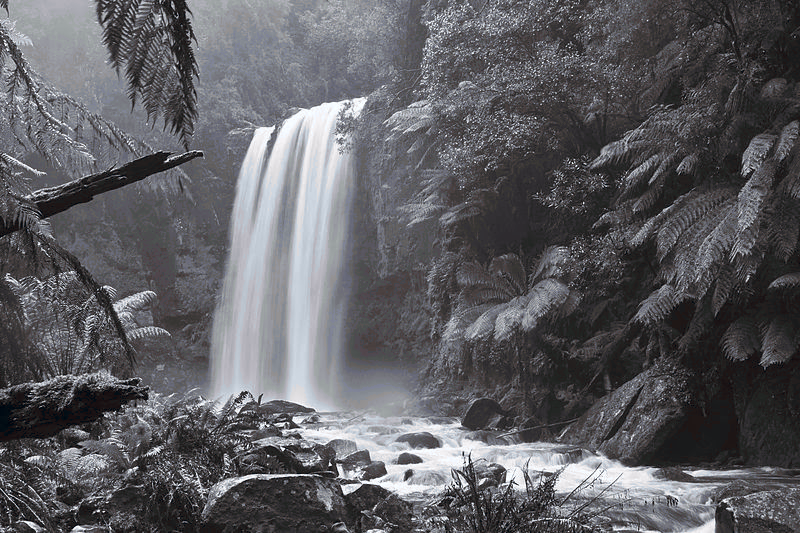

In [ ]:
# Convert the output LAB image to BGR color space
output_bgr_image = cv2.cvtColor(output_lab_image, cv2.COLOR_Lab2BGR)

# Display the output image
cv2_imshow(output_bgr_image)

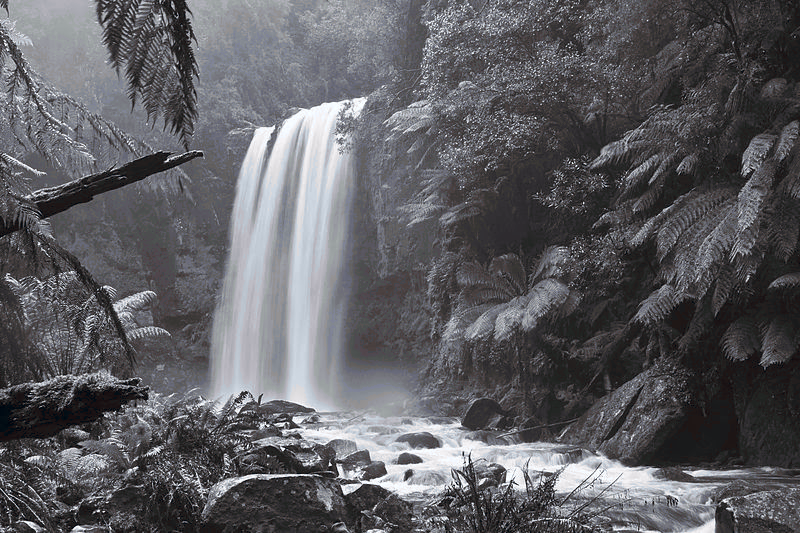

In [ ]:
cv2_imshow(output_bgr_image)

In [ ]:
# Convert images to float32 to avoid integer overflow during subtraction
output_bgr_float = output_bgr_image.astype(np.float32)
image2_float = image2.astype(np.float32)

# Calculate squared difference between pixel values
squared_diff = (output_bgr_float - image2_float) ** 2

# Calculate mean squared error (MSE)
output_mse = np.mean(squared_diff)

print("Mean Squared Error (MSE):", output_mse)

Mean Squared Error (MSE): 250.97531


# WITH SWATCHES

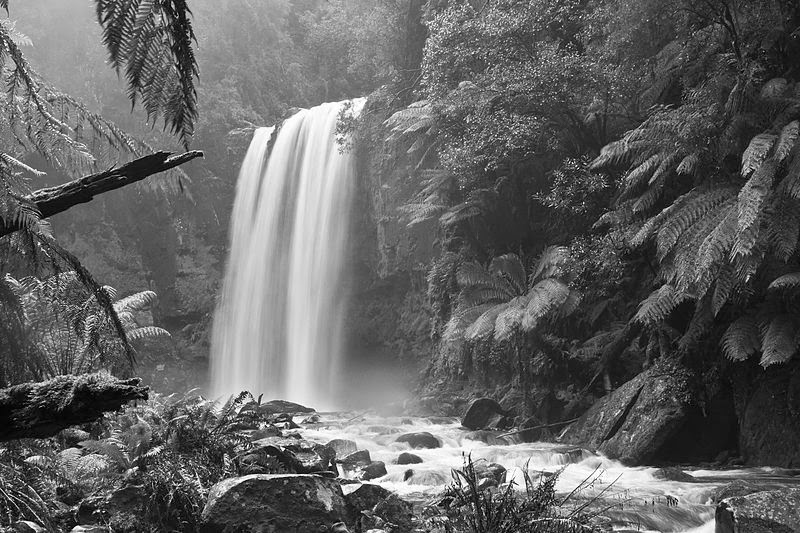

In [ ]:
cv2_imshow(grayscale_image2)

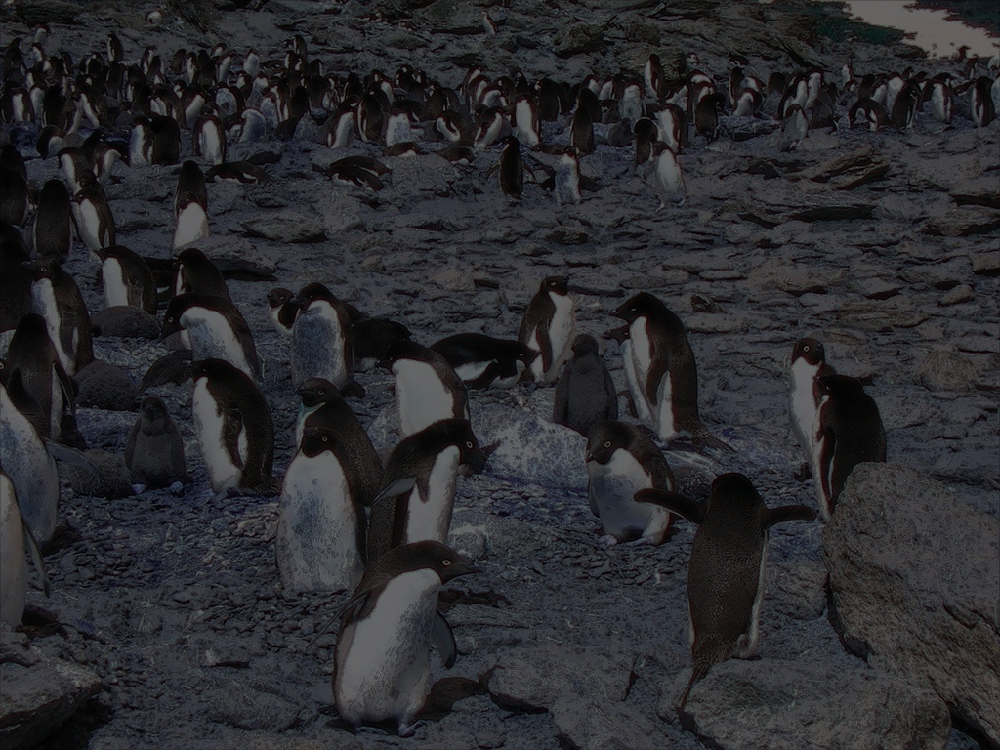

In [ ]:
cv2_imshow(artistic_image)

In [ ]:
# Get the height and width of the dithered image
artistic_height, artistic_width, _ = artistic_image.shape

# Get the height and width of the grayscale image
grayscale_height, grayscale_width = grayscale_image2.shape

print("artistic Image Height:", artistic_height)
print("artistic Image Width:", artistic_width)

print("Grayscale Image Height:", grayscale_height)
print("Grayscale Image Width:", grayscale_width)


artistic Image Height: 768
artistic Image Width: 1024
Grayscale Image Height: 533
Grayscale Image Width: 800


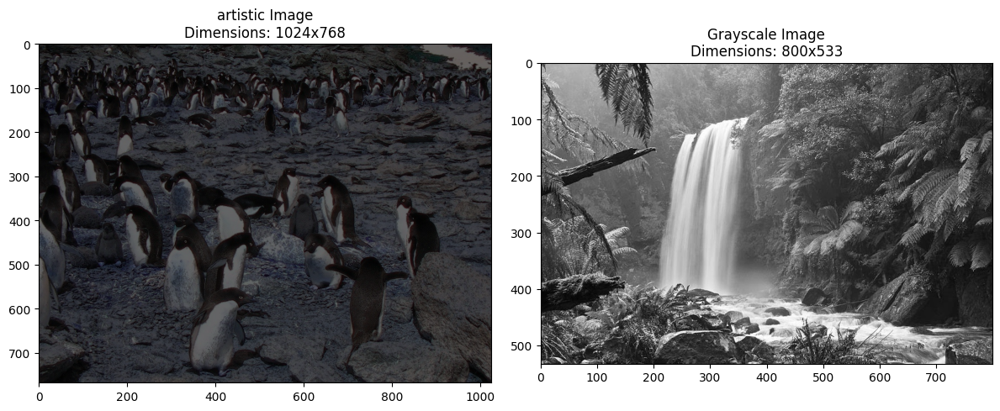

In [ ]:
# Create a figure and axis
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

# Display dithered image with its dimensions and coordinates
ax1.imshow(cv2.cvtColor(artistic_image, cv2.COLOR_BGR2RGB))
ax1.set_title(f"artistic Image\nDimensions: {artistic_width}x{artistic_height}")
ax1.axis('on')

# Display grayscale image2 with its dimensions and coordinates
ax2.imshow(grayscale_image2, cmap='gray')
ax2.set_title(f"Grayscale Image\nDimensions: {grayscale_width}x{grayscale_height}")
ax2.axis('on')

plt.tight_layout()
plt.show()

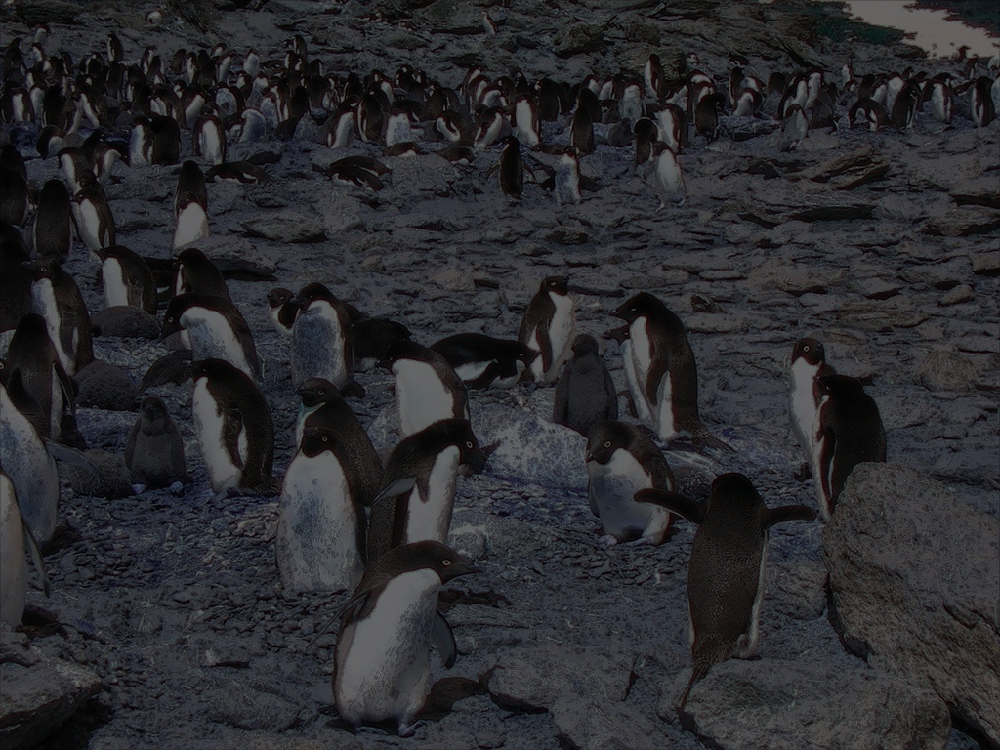

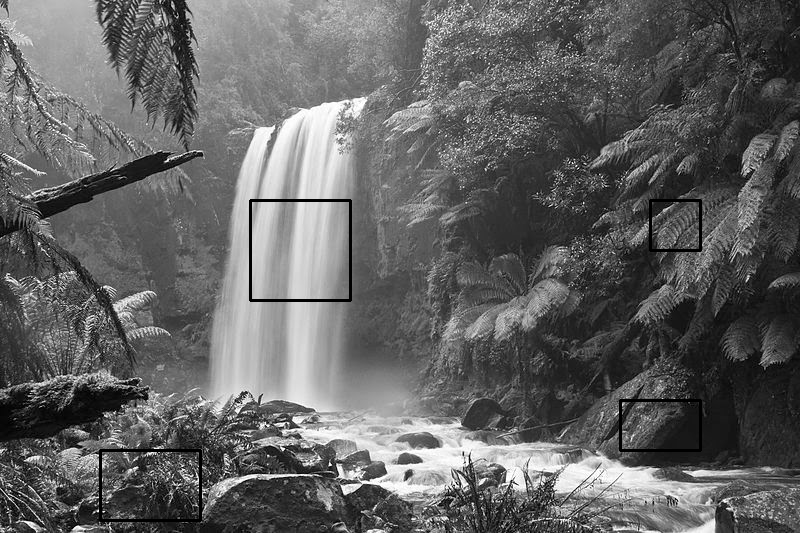

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
from IPython.display import display
import matplotlib.pyplot as plt

# Define a function to draw a rectangle between two coordinates on the image
def draw_rectangle(image, coord1, coord2, color=(0, 255, 0), thickness=2):
    x1, y1 = coord1
    x2, y2 = coord2
    image_with_rectangle = image.copy()
    cv2.rectangle(image_with_rectangle, (x1, y1), (x2, y2), color, thickness)
    return image_with_rectangle

# Define rectangle coordinates for both images
rectangle_coords_artistic = [(900,900,950,800), (1500,800,1750,600),(1500,800,1750,600),(1300,250,1500,150)]  # List of (x1, y1, x2, y2) coordinates
rectangle_coords_grayscale = [(250,300,350,200), (650,250,700,200),(100,520,200,450),(620,450,700,400)]  # List of (x1, y1, x2, y2) coordinates

# Draw rectangles on the images
artistic_image_with_rectangles = artistic_image.copy()
grayscale_image_with_rectangles = grayscale_image2.copy()

for rect_coords in rectangle_coords_artistic:
    artistic_image_with_rectangles = draw_rectangle(artistic_image_with_rectangles, rect_coords[:2], rect_coords[2:])

for rect_coords in rectangle_coords_grayscale:
    grayscale_image_with_rectangles = draw_rectangle(grayscale_image_with_rectangles, rect_coords[:2], rect_coords[2:])

# Display the images with rectangles
cv2_imshow(artistic_image_with_rectangles)
cv2_imshow(grayscale_image_with_rectangles)


In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# Convert the dithered image to LAB color space
artistic_lab = cv2.cvtColor(artistic_image, cv2.COLOR_BGR2Lab)

# Define rectangle coordinates for both images
rectangle_coords_artistic = [(900,900,950,800), (1500,800,1750,600),(1500,800,1750,600),(1300,250,1500,150)]  # List of (x1, y1, x2, y2) coordinates
rectangle_coords_grayscale = [(250,300,350,200), (650,250,700,200),(100,520,200,450),(620,450,700,400)]  # List of (x1, y1, x2, y2) coordinates

# Perform histogram matching and color transfer between corresponding regions
for source_coords, target_coords in zip(rectangle_coords_artistic, rectangle_coords_grayscale):
    x1_source, y1_source, x2_source, y2_source = source_coords
    x1_target, y1_target, x2_target, y2_target = target_coords

    # Ensure correct ordering of coordinates
    x_min_source, x_max_source = min(x1_source, x2_source), max(x1_source, x2_source)
    y_min_source, y_max_source = min(y1_source, y2_source), max(y1_source, y2_source)

    source_channel = artistic_lab[y_min_source:y_max_source, x_min_source:x_max_source]
    cv2_imshow(source_channel)
    source_l_channel = artistic_lab[y_min_source:y_max_source, x_min_source:x_max_source, 0]

    # Print the shapes of the extracted source L channel
    print("Source L Channel Shape:", source_l_channel.shape)

    # Print the source and target coordinates
    print("Source Coordinates:", x1_source, y1_source, x2_source, y2_source)
    print("Target Coordinates:", x1_target, y1_target, x2_target, y2_target)
    cv2_imshow(source_l_channel)

error: ignored

In [ ]:
# Perform histogram matching and color transfer between corresponding regions
for source_coords, target_coords in zip(rectangle_coords_artistic, rectangle_coords_grayscale):
    x1_source, y1_source, x2_source, y2_source = source_coords
    x1_target, y1_target, x2_target, y2_target = target_coords

    # Ensure correct ordering of coordinates
    x_min_source, x_max_source = min(x1_source, x2_source), max(x1_source, x2_source)
    y_min_source, y_max_source = min(y1_source, y2_source), max(y1_source, y2_source)

    x_min_target, x_max_target = min(x1_target, x2_target), max(x1_target, x2_target)
    y_min_target, y_max_target = min(y1_target, y2_target), max(y1_target, y2_target)

    # Extract the source L channel and target region from the LAB image and grayscale image
    source_l_channel = artistic_lab[y_min_source:y_max_source, x_min_source:x_max_source, 0]
    target_intensity = grayscale_image2[y_min_target:y_max_target, x_min_target:x_max_target]

    # Calculate the histogram of the target swatch
    target_histogram, _ = np.histogram(target_intensity.flatten(), bins=256, range=(0, 256), density=True)
    target_cumulative_histogram = np.cumsum(target_histogram)

    # Perform histogram equalization on the source swatch
    source_swatch_equalized = np.interp(source_l_channel, np.arange(256), target_cumulative_histogram * 255).astype(np.uint8)


    # Print the shapes of the extracted source L channel
    print("Source L Channel Shape:", source_l_channel.shape)

    # Print the source and target coordinates
    print("Source Coordinates:", x1_source, y1_source, x2_source, y2_source)
    print("Target Coordinates:", x1_target, y1_target, x2_target, y2_target)

    # Select 50 random pixels from the source L channel
    #random_indices = np.random.choice(source_l_channel.size, size=50, replace=False)
    #random_l_values = source_l_channel.flat[random_indices]

    # Select 50 random pixels from the source L channel
    random_indices = np.random.choice(source_l_channel.size, size=50, replace=False)
    random_pixels = source_l_channel.flat[random_indices]




    # Initialize the colorized target region
    colorized_target_region = np.zeros((y_max_target - y_min_target, x_max_target - x_min_target, 3), dtype=np.uint8)

    # Iterate through target intensity values and assign colors based on closest L value
    for y in tqdm(range(y_min_target, y_max_target)):
        for x in range(x_min_target, x_max_target):
            target_intensity_value = target_intensity[y - y_min_target, x - x_min_target]
            min_diff = np.inf
            selected_l_value = None

            for l_value in random_pixels:
                diff = np.abs(target_intensity_value - l_value)
                if diff < min_diff:
                    min_diff = diff
                    selected_l_value = l_value

            # Get the corresponding A and B values from the source LAB image
            corresponding_ab_values = artistic_lab[y_min_source + y - y1_source, x_min_source + x - x1_source, 1:]

            # Assign the selected L value and corresponding A and B values to the target region
            colorized_target_region[y - y_min_target, x - x_min_target] = [selected_l_value, corresponding_ab_values[0], corresponding_ab_values[1]]

    # Convert the colorized target region to BGR color space
    colorized_target_region_bgr = cv2.cvtColor(colorized_target_region, cv2.COLOR_Lab2BGR)
    print(colorized_target_region_bgr)
    # Display the colorized target region
    cv2_imshow(colorized_target_region_bgr)

In [ ]:
patch_size=5

In [ ]:
import numpy as np
import cv2
import random
from tqdm import tqdm

# ... Assuming you have the colorized_target_region_bgr from the previous code
colorized_target_lab = cv2.cvtColor(colorized_target_region_bgr, cv2.COLOR_BGR2Lab)

# Define the patch and swatch sizes
patch_size = 5
swatch_size = 5

# Extract all possible swatch patches
swatch_patches = []
for y in range(0, colorized_target_lab.shape[0] - swatch_size + 1, swatch_size):
    for x in range(0, colorized_target_lab.shape[1] - swatch_size + 1, swatch_size):
        swatch_patch = colorized_target_lab[y:y+swatch_size, x:x+swatch_size]
        swatch_patches.append(swatch_patch)

# Create a new LAB image with the same dimensions as the grayscale image
new_lab_image = np.zeros((grayscale_image2.shape[0], grayscale_image2.shape[1], 3), dtype=np.uint8)

# Loop through the grayscale image in patches
for y in tqdm(range(0, grayscale_image2.shape[0] - patch_size + 1, patch_size)):
    for x in range(0, grayscale_image2.shape[1] - patch_size + 1, patch_size):
        # Extract the intensity values of the patch from the grayscale image
        patch_intensity = grayscale_image2[y:y+patch_size, x:x+patch_size]

        # Calculate errors for each swatch patch
        errors = []
        for swatch_patch in swatch_patches:
            n_values = np.abs(patch_intensity - swatch_patch[:, :, 0])
            exact_error = np.sum(n_values ** 2)
            errors.append(exact_error)

        # Select the best swatch patch with the lowest error
        best_swatch_index = np.argmin(errors)
        best_swatch_patch = swatch_patches[best_swatch_index]

        # Calculate the mean A and B values from the best swatch patch
        mean_ab_values = np.mean(best_swatch_patch[:, :, 1:], axis=(0, 1))

        # Create a new LAB patch with the mean A and B values and the original L channel
        new_patch_lab = np.zeros((patch_size, patch_size, 3), dtype=np.uint8)
        new_patch_lab[:, :, 0] = patch_intensity
        new_patch_lab[:, :, 1:] = mean_ab_values

        # Resize the new LAB patch to match the dimensions of the patch in the new LAB image
        new_patch_lab_resized = cv2.resize(new_patch_lab, (patch_size, patch_size))

        # Assign the new LAB patch to the corresponding region in the new LAB image
        new_lab_image[y:y+patch_size, x:x+patch_size] = new_patch_lab_resized


# Convert the new LAB image to BGR color space
new_bgr_image = cv2.cvtColor(new_lab_image, cv2.COLOR_Lab2BGR)

# Display the new colored image
cv2_imshow(new_bgr_image)


In [ ]:
# Convert images to float32 to avoid integer overflow during subtraction
new_bgr_float = new_bgr_image.astype(np.float32)
image2_float = image2.astype(np.float32)

# Calculate squared difference between pixel values
squared_diff = (new_bgr_float - image2_float) ** 2

# Calculate mean squared error (MSE)
mse = np.mean(squared_diff)

print("Mean Squared Error (MSE):", mse)